# Big data Project CSC 3303 - Sem2 - 2020/2021
# Group members:
       - Conde Lancine 1729355
       - Ramzi Maresh Ahmed 1626871
       - Md Raisul Islam 1725501
       - Abozabna nasr 1621235     

In [1]:
#Import the libraries

%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score,GridSearchCV
from sklearn.metrics import confusion_matrix,accuracy_score,f1_score,classification_report,roc_auc_score,roc_curve
from sklearn.preprocessing import StandardScaler
from sklearn import model_selection
from sklearn import metrics
from scipy.stats import zscore
import matplotlib.pyplot as plt 

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score

In [2]:
#import the dataset 
df=pd.read_csv("C:\\Users\\User\\Downloads\\archive (4)\\products-of-animal-origin-september-2018-32.csv")
df

,YearOfDeclaration,QuarterOfDeclaration,MonthOfDeclaration,DayOfDeclaration,ConsignorCountry,EntryBIPcountryISOcode,BorderInspectionPost,ConsigneeCountry,ImporterCountry,CountryOfOrigin,CountryFromWhereConsigned,DeliveryISO,DeliveryType,ForRe_import,ForInternalMarket,GrossWeight_Kg,TotalNetWeight_Kg,TransshipmentExitBIPcountryISOcode,ExitBIPcountryTransit,DocumentaryCheck,IdentityCheck,PhysicalCheck,LaboratoryTests1,TestedFor,Results1,AcceptableForTranshipment,TranshipmentBIP,TranshipmentEU_BIP,TranshipmentUnitNumber,TransitTo3rdCountry,TransitExitBIP,TracesUnitNumber,AcceptableForInternalMarket,AcceptableForSpecificWarehouseProcedure_Article12.4and13,NotAcceptable,RefusalReasons,DateOfSignature,YearOfDecision,QuarterOfDecision,MonthOfDecision,DayOfDecision,Commodity,Commodity_List,Species,Species_List,LaboratoryTests2
0,2018,Q3,9,19,IN,GB,"Felixstowe, P",GB,GB,IN,IN,GB,CVEDP,No,Human Consumption,24500,20000,/,/,Satisfactory,Satisfactory,Not Done,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,9/25/2018,2018,Q3,9,25,3061799,3061799,Metapenaeus Spp,Metapenaeus Spp,-
1,2018,Q3,9,25,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,0,0,/,/,Satisfactory,Satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,10/5/2018,2018,Q4,10,5,3038990,03038990|03048100|03048910|16041991,Mugil Spp,Coregonus Spp|Merluccius Capensis|Mugil Spp|Sa...,-
2,2018,Q3,9,25,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,0,0,/,/,Satisfactory,Satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,10/5/2018,2018,Q4,10,5,3048100,03038990|03048100|03048910|16041991,Salmo Salar,Coregonus Spp|Merluccius Capensis|Mugil Spp|Sa...,-
3,2018,Q3,9,25,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,0,0,/,/,Satisfactory,Satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,10/5/2018,2018,Q4,10,5,3048910,03038990|03048100|03048910|16041991,Coregonus Spp,Coregonus Spp|Merluccius Capensis|Mugil Spp|Sa...,-
4,2018,Q3,9,25,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,1895,1763,/,/,Satisfactory,Satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,10/5/2018,2018,Q4,10,5,16041991,03038990|03048100|03048910|16041991,Merluccius Capensis,Coregonus Spp|Merluccius Capensis|Mugil Spp|Sa...,-
5,2018,Q3,9,25,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,0,0,/,/,Satisfactory,Satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,10/5/2018,2018,Q4,10,5,3048910,03048910|16041991,Coregonus Spp,Coregonus Spp|Merluccius Capensis,-
6,2018,Q3,9,25,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,335,317,/,/,Satisfactory,Satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,10/5/2018,2018,Q4,10,5,16041991,03048910|16041991,Merluccius Capensis,Coregonus Spp|Merluccius Capensis,-
7,2018,Q3,9,3,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,471,435,/,/,Not satisfactory,Not satisfactory,Satisfactory,No,-,-,-,/,-,/,-,/,/,-,-,2. Destruction,1. Absence/Invalid Certificate,9/6/2018,2018,Q3,9,6,4090000,4090000,Apis Melifera,Apis Melifera,-
8,2018,Q3,9,4,US,GB,"Felixstowe, P",GB,GB,US,US,GB,CVEDP,No,Human Consumption,54,44,/,/,Not satisfactory,Not satisfactory,-,No,-,-,-,/,-,/,-,/,/,-,-,2. Destruction,1. Absence/Invalid Certificate,9/6/2018,2018,Q3,9,6,16041390,16041390,Sardina Pilchardus,Sardina Pilchardus,-
9,2018,Q3,9,4,AU,GB,Heathrow,GB,GB,AU,AU,GB,CVEDP,No,Human Consumption,0,0,/,/,Satisfactory,Satisfactory,Not Done,No,-,-,-,/,-,/,-,/,/,Human Consumption,-,-,-,9/6/2018,2018,Q3,9,6,20120,020120|020130,Bos Taurus,Bos Taurus,-


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7076 entries, 0 to 7075
Data columns (total 46 columns):
 #   Column                                                    Non-Null Count  Dtype 
---  ------                                                    --------------  ----- 
 0   YearOfDeclaration                                         7076 non-null   int64 
 1   QuarterOfDeclaration                                      7076 non-null   object
 2   MonthOfDeclaration                                        7076 non-null   int64 
 3   DayOfDeclaration                                          7076 non-null   int64 
 4   ConsignorCountry                                          7067 non-null   object
 5   EntryBIPcountryISOcode                                    7076 non-null   object
 6   BorderInspectionPost                                      7076 non-null   object
 7   ConsigneeCountry                                          7076 non-null   object
 8   ImporterCountry             

In [5]:
# Find a duplicate rows
duplicate_df = df[df.duplicated(keep='last')]
print(duplicate_df)

      YearOfDeclaration QuarterOfDeclaration  MonthOfDeclaration  \
90                 2018                   Q3                   9   
95                 2018                   Q3                   9   
102                2018                   Q3                   9   
103                2018                   Q3                   9   
104                2018                   Q3                   9   
105                2018                   Q3                   9   
108                2018                   Q3                   9   
109                2018                   Q3                   9   
208                2018                   Q3                   9   
209                2018                   Q3                   9   
210                2018                   Q3                   9   
232                2018                   Q3                   9   
236                2018                   Q3                   9   
237                2018                   Q3    

In [6]:
#Drop duplicate rows
df = df.drop_duplicates(keep='last')
df.reset_index(inplace=True)
del df['index']
df.shape

(6792, 46)

In [7]:
# print all the columns 
print(df.columns) 

Index(['YearOfDeclaration', 'QuarterOfDeclaration', 'MonthOfDeclaration',
       'DayOfDeclaration', 'ConsignorCountry', 'EntryBIPcountryISOcode',
       'BorderInspectionPost', 'ConsigneeCountry', 'ImporterCountry',
       'CountryOfOrigin', 'CountryFromWhereConsigned', 'DeliveryISO',
       'DeliveryType', 'ForRe_import', 'ForInternalMarket', 'GrossWeight_Kg',
       'TotalNetWeight_Kg', 'TransshipmentExitBIPcountryISOcode',
       'ExitBIPcountryTransit', 'DocumentaryCheck', 'IdentityCheck',
       'PhysicalCheck', 'LaboratoryTests1', 'TestedFor', 'Results1',
       'AcceptableForTranshipment', 'TranshipmentBIP', 'TranshipmentEU_BIP',
       'TranshipmentUnitNumber', 'TransitTo3rdCountry', 'TransitExitBIP',
       'TracesUnitNumber', 'AcceptableForInternalMarket',
       'AcceptableForSpecificWarehouseProcedure_Article12.4and13',
       'NotAcceptable', 'RefusalReasons', 'DateOfSignature', 'YearOfDecision',
       'QuarterOfDecision', 'MonthOfDecision', 'DayOfDecision', 'Commodity',

In [8]:
# Checking for null values 
df.isnull().sum()

YearOfDeclaration                                              0
QuarterOfDeclaration                                           0
MonthOfDeclaration                                             0
DayOfDeclaration                                               0
ConsignorCountry                                               9
EntryBIPcountryISOcode                                         0
BorderInspectionPost                                           0
ConsigneeCountry                                               0
ImporterCountry                                                0
CountryOfOrigin                                                9
CountryFromWhereConsigned                                      1
DeliveryISO                                                    0
DeliveryType                                                   0
ForRe_import                                                   0
ForInternalMarket                                              0
GrossWeight_Kg           

In [9]:
# the column name 'Species_List' almost empty so drop it 
df.dropna(subset=['Species_List'], inplace=True)

<ipython-input-9-10aeabd306d3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(subset=['Species_List'], inplace=True)


In [10]:
# Showing the most unique countries 
df.CountryOfOrigin.unique()

array(['IN', 'US', 'AU', 'OM', 'TH', 'MX', 'NZ', 'VN', 'CL'], dtype=object)

In [11]:
# Drop na values 
df.dropna(inplace=True)

<ipython-input-11-f112a865c8b7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(inplace=True)


In [12]:
# check if the data cleaned 
df.isnull().sum()

YearOfDeclaration                                           0
QuarterOfDeclaration                                        0
MonthOfDeclaration                                          0
DayOfDeclaration                                            0
ConsignorCountry                                            0
EntryBIPcountryISOcode                                      0
BorderInspectionPost                                        0
ConsigneeCountry                                            0
ImporterCountry                                             0
CountryOfOrigin                                             0
CountryFromWhereConsigned                                   0
DeliveryISO                                                 0
DeliveryType                                                0
ForRe_import                                                0
ForInternalMarket                                           0
GrossWeight_Kg                                              0
TotalNet

In [13]:
# Describe the data
df.describe()

,YearOfDeclaration,MonthOfDeclaration,DayOfDeclaration,GrossWeight_Kg,TotalNetWeight_Kg,YearOfDecision,MonthOfDecision,DayOfDecision,Commodity
count,88.0,88.0,88.000000,88.000000,88.000000,88.0,88.000000,88.000000,8.800000e+01
mean,2018.0,9.0,14.272727,7611.181818,6999.056818,2018.0,9.215909,13.170455,2.561257e+06
std,0.0,0.0,8.308322,9370.433112,8581.291553,0.0,0.413809,8.736529,4.085385e+06
min,2018.0,9.0,3.000000,0.000000,0.000000,2018.0,9.000000,1.000000,2.012000e+04
25%,2018.0,9.0,5.000000,0.000000,0.000000,2018.0,9.000000,6.000000,4.040500e+04
50%,2018.0,9.0,16.500000,2398.000000,2183.500000,2018.0,9.000000,12.000000,2.042250e+06
75%,2018.0,9.0,20.000000,12989.250000,12254.500000,2018.0,9.000000,20.250000,2.044310e+06
max,2018.0,9.0,30.000000,27550.000000,25344.000000,2018.0,10.000000,30.000000,2.103909e+07


# 1-Which country produces the most products of animal origin? 

In [14]:
proportion = df.CountryOfOrigin.value_counts().head(20)
proportion

NZ    41
US    16
AU    10
CL    10
VN     4
IN     3
TH     2
MX     1
OM     1
Name: CountryOfOrigin, dtype: int64

C:\Users\User\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='CountryOfOrigin'>

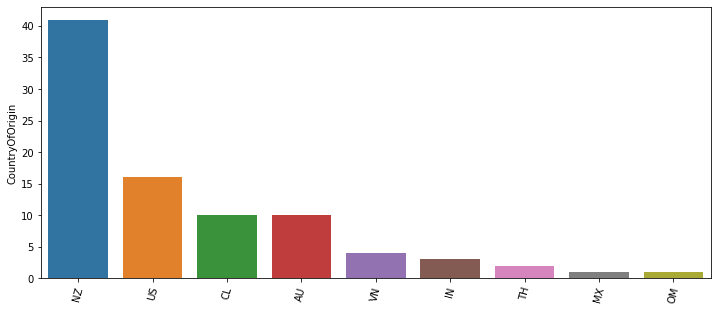

In [120]:
plt.figure(figsize=(12,5))
plt.xticks(rotation= 75)
sns.barplot(proportion.index,proportion)

# 2-what are the reasons that often make some products being refused on the market? 

In [15]:
df.RefusalReasons.unique()

array(['-', '1. Absence/Invalid Certificate', '4. Prohibited Product',
       '6. Id: Health Mark Error'], dtype=object)

In [16]:
refusal = df.RefusalReasons.value_counts()
refusal

-                                 81
1. Absence/Invalid Certificate     5
4. Prohibited Product              1
6. Id: Health Mark Error           1
Name: RefusalReasons, dtype: int64

In [18]:
# There is 81 respone with no reasons sign(-) so we change it to No reson for more clearification 
df["RefusalReasons"].replace({"-": "no_reson" }, inplace=True)

In [19]:
refusal = df.RefusalReasons.value_counts()
refusal

no_reson                          81
1. Absence/Invalid Certificate     5
4. Prohibited Product              1
6. Id: Health Mark Error           1
Name: RefusalReasons, dtype: int64

# 3-How to analyse each country's productivity based on their percentage of success during the physical test and the identity check?


In [20]:
#
a=df[df['PhysicalCheck']== 'Satisfactory']
city_group=a.groupby(['ConsigneeCountry'])
a=city_group['PhysicalCheck'].value_counts()
a

ConsigneeCountry  PhysicalCheck
DE                Satisfactory      2
GB                Satisfactory     11
Name: PhysicalCheck, dtype: int64

In [21]:
#
b=df[df['IdentityCheck']== 'Satisfactory']
city_group=b.groupby(['ConsigneeCountry'])
b=city_group['IdentityCheck'].value_counts()
b

ConsigneeCountry  IdentityCheck
DE                Satisfactory     10
GB                Satisfactory     74
NL                Satisfactory      1
Name: IdentityCheck, dtype: int64

<AxesSubplot:ylabel='PhysicalCheck'>

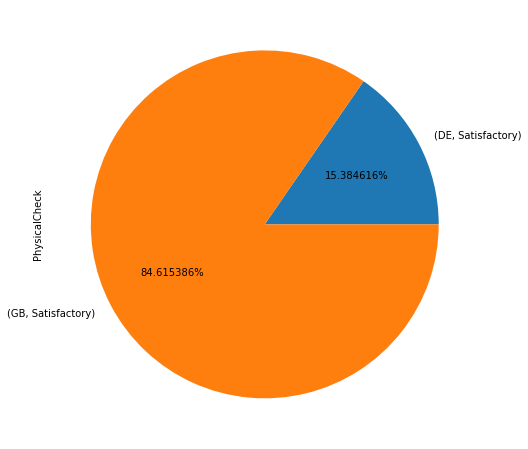

In [23]:
# convert the result to graph and showing the precentage 
a.plot(kind='pie', figsize=(12,8), autopct='%1f%%')

<AxesSubplot:ylabel='IdentityCheck'>

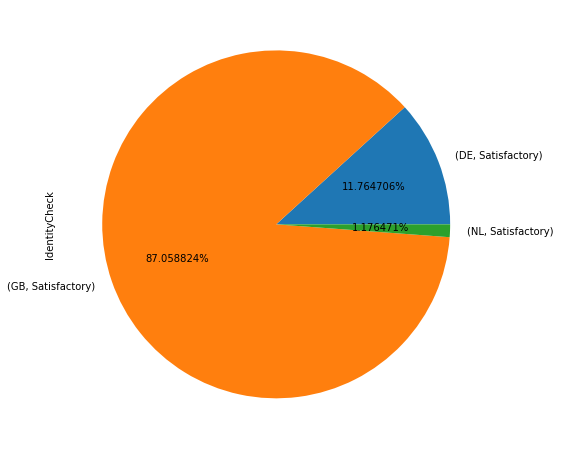

In [24]:
b.plot(kind='pie', figsize=(12,8), autopct='%1f%%')

# 4-Does the type of species have an impact on the result of the physical test? 


In [25]:
#
species_group=df.groupby(['Species'])
b=species_group['PhysicalCheck'].value_counts()
b


Species                  PhysicalCheck
Apis Melifera            Satisfactory      1
Bos Taurus               Not Done         21
                         Satisfactory      3
Coregonus Spp            Satisfactory      2
Gallus Gallus            Not Done          4
                         Satisfactory      2
Merluccius Capensis      Satisfactory      2
Metapenaeus Spp          Not Done          1
Mugil Spp                Satisfactory      1
Otra                     Not Done          2
Ovis Aries               Not Done         40
Pangasius Hypophthalmus  Not Done          4
Salmo Salar              Satisfactory      1
Sardina Pilchardus       -                 1
Stolephorus Spp          Not Done          2
Ungulates                Satisfactory      1
Name: PhysicalCheck, dtype: int64

<AxesSubplot:xlabel='Species,PhysicalCheck'>

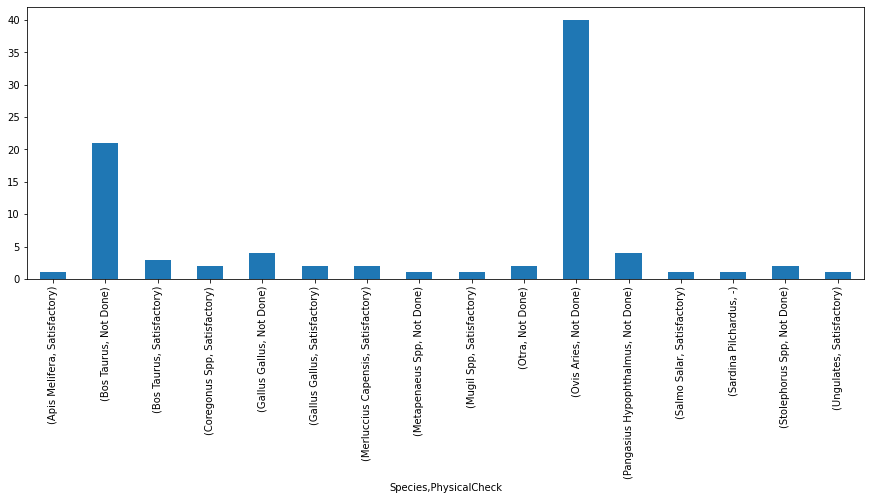

In [26]:
#better understanding by graph
b.plot(kind='bar', figsize=(15,5))

# 5-A company wants to start producing products of animal origins. What is your advice to the company? 


Based on the previous question, the company is to be advised to invest in the production of product made with "Bos Taurus" 
since it has the highest percentage of success among all the other species.
The second advice will be if possible to settle in Great Britain since products coming from the place mostly passe both the 
identity check and the physical test.

# Modelling 

In [27]:
df['Species'].value_counts()

Ovis Aries                 40
Bos Taurus                 24
Gallus Gallus               6
Pangasius Hypophthalmus     4
Stolephorus Spp             2
Merluccius Capensis         2
Otra                        2
Coregonus Spp               2
Metapenaeus Spp             1
Sardina Pilchardus          1
Ungulates                   1
Mugil Spp                   1
Apis Melifera               1
Salmo Salar                 1
Name: Species, dtype: int64

In [28]:
df['Species']=df['Species'].map({'Ovis Aries':0 ,'Bos Taurus':1,'Gallus Gallus':2,'Pangasius Hypophthalmus':3,'Otra':4,
            'Stolephorus Spp':5,'Coregonus Spp':6,'Merluccius Capensis':7,'Mugil Spp':8,'Metapenaeus Spp':9,'Apis Melifera':10,
               'Salmo Salar':11,'Ungulates ':12,'Sardina Pilchardus ':13 })

<ipython-input-28-1a47d21acc87>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Species']=df['Species'].map({'Ovis Aries':0 ,'Bos Taurus':1,'Gallus Gallus':2,'Pangasius Hypophthalmus':3,'Otra':4,


In [29]:
df['Species'].value_counts()

0.0     40
1.0     24
2.0      6
3.0      4
4.0      2
5.0      2
7.0      2
6.0      2
10.0     1
11.0     1
8.0      1
9.0      1
Name: Species, dtype: int64

In [30]:
df.corr()

,YearOfDeclaration,MonthOfDeclaration,DayOfDeclaration,GrossWeight_Kg,TotalNetWeight_Kg,YearOfDecision,MonthOfDecision,DayOfDecision,Commodity,Species
YearOfDeclaration,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MonthOfDeclaration,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DayOfDeclaration,NaN,NaN,1.000000,-0.184877,-0.190003,NaN,0.564399,0.263961,0.121930,0.189695
GrossWeight_Kg,NaN,NaN,-0.184877,1.000000,0.997157,NaN,-0.215825,0.227613,-0.152930,0.018146
TotalNetWeight_Kg,NaN,NaN,-0.190003,0.997157,1.000000,NaN,-0.213502,0.220069,-0.160696,-0.007667
YearOfDecision,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MonthOfDecision,NaN,NaN,0.564399,-0.215825,-0.213502,NaN,1.000000,-0.544431,0.388568,0.350043
DayOfDecision,NaN,NaN,0.263961,0.227613,0.220069,NaN,-0.544431,1.000000,-0.155342,-0.178119
Commodity,NaN,NaN,0.121930,-0.152930,-0.160696,NaN,0.388568,-0.155342,1.000000,0.427348
Species,NaN,NaN,0.189695,0.018146,-0.007667,NaN,0.350043,-0.178119,0.427348,1.000000


In [31]:
df1 = df[['DayOfDeclaration', 'GrossWeight_Kg','TotalNetWeight_Kg','Commodity','Species']]
df1

,DayOfDeclaration,GrossWeight_Kg,TotalNetWeight_Kg,Commodity,Species
0,19,24500,20000,3061799,9.0
1,25,0,0,3038990,8.0
2,25,0,0,3048100,11.0
3,25,0,0,3048910,6.0
4,25,1895,1763,16041991,7.0
5,25,0,0,3048910,6.0
6,25,335,317,16041991,7.0
7,3,471,435,4090000,10.0
8,4,54,44,16041390,NaN
9,4,0,0,20120,1.0


In [32]:
df1=df1.dropna()

In [33]:
X = df1.drop(columns = ['Species'])
y = df1['Species']

In [34]:
#Splitting data into train and test 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

In [35]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print( y_test.shape)

(60, 4)
(26, 4)
(60,)
(26,)


# K Nearest Neighbors classifier

In [37]:
from sklearn.neighbors import KNeighborsClassifier
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)
knn_score = knn_clf.score(X_test, y_test)
print("Accuracy:",knn_score)

Accuracy: 0.8461538461538461


In [38]:
knn_grid = {'n_neighbors': np.arange(2, 15),
            'leaf_size': [10, 15, 20, 25, 30, 35, 40, 45, 50],
            'p':[1,2,3,4,5], 
            'algorithm': ['auto', 'ball_tree', 'kd_tree']}

knn_gscv = GridSearchCV(KNeighborsClassifier(),
                        param_grid=knn_grid,
                        cv=5,
                        verbose=True)

knn_gscv.fit(X_train, y_train)
knn_tuned_score = knn_gscv.score(X_test, y_test)
print("Accuracy:",knn_tuned_score)

Fitting 5 folds for each of 1755 candidates, totalling 8775 fits


C:\Users\User\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:670: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(("The least populated class in y has only %d"
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Accuracy: 0.8846153846153846


[Parallel(n_jobs=1)]: Done 8775 out of 8775 | elapsed:   55.3s finished


# Random Forest classifier 

In [39]:
#importing RandomForestClassifier
from sklearn.ensemble import RandomForestClassifier
#importing RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV

In [40]:
#defining grid for randomsearchcv
rscv_grid = {"n_estimators": np.arange(10, 1000, 20),
           "max_depth": [None, 3, 5, 7, 10],
           "min_samples_split": np.arange(2, 20, 2),
           "min_samples_leaf": np.arange(1, 20, 2)}

In [41]:
np.random.seed(10)

# Setup random hyperparameter search for RandomForestClassifier
rscv_clf = RandomizedSearchCV(RandomForestClassifier(),
                           param_distributions=rscv_grid,
                           cv=5,
                           n_iter=100,
                           verbose=True)

# Fit random hyperparameter search model
rscv_clf.fit(X_train, y_train);

C:\Users\User\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:670: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(("The least populated class in y has only %d"
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 100 candidates, totalling 500 fits


[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:  7.0min finished


In [42]:
rscv_clf.best_params_

{'n_estimators': 490,
 'min_samples_split': 10,
 'min_samples_leaf': 1,
 'max_depth': 5}

In [43]:
# Making preidctions on test set
y_preds = rscv_clf.predict(X_test)

In [44]:
tr_rscv=round(rscv_clf.score(X_train, y_train),4)
te_rscv=round(rscv_clf.score(X_train, y_train),4)

print('Training accuracy of Random forest model :',tr_rscv)
print('Testing  accuracy of Random forest model :',te_rscv)

Training accuracy of Random forest model : 0.8667
Testing  accuracy of Random forest model : 0.8667


In [45]:
##classification_report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_preds))

              precision    recall  f1-score   support

         0.0       0.93      1.00      0.97        14
         1.0       0.67      1.00      0.80         4
         2.0       0.75      1.00      0.86         3
         3.0       1.00      1.00      1.00         1
         4.0       0.00      0.00      0.00         1
         5.0       0.00      0.00      0.00         1
        10.0       0.00      0.00      0.00         1
        11.0       0.00      0.00      0.00         1

    accuracy                           0.85        26
   macro avg       0.42      0.50      0.45        26
weighted avg       0.73      0.85      0.78        26



C:\Users\User\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
